This notebook is working on [DFL - Bundesliga Data Shootout][1] , you can open the notebook on kaggle and run it from this [link][2].

[1]: https://www.kaggle.com/competitions/dfl-bundesliga-data-shootout
[2]: https://www.kaggle.com/code/ahmedtarek26/eda-dfl-bundesliga-data-shootout#Sample-of-submission


## train data

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import plotly.express as px
import matplotlib.pyplot as plt
from statsmodels.graphics.mosaicplot import mosaic
import cv2
# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/dfl-bundesliga-data-shootout/sample_submission.csv
/kaggle/input/dfl-bundesliga-data-shootout/train.csv
/kaggle/input/dfl-bundesliga-data-shootout/clips/54745b_5.mp4
/kaggle/input/dfl-bundesliga-data-shootout/clips/0bfacc_5.mp4
/kaggle/input/dfl-bundesliga-data-shootout/clips/ec783a_6.mp4
/kaggle/input/dfl-bundesliga-data-shootout/clips/cd987c_1.mp4
/kaggle/input/dfl-bundesliga-data-shootout/clips/798b45_1.mp4
/kaggle/input/dfl-bundesliga-data-shootout/clips/55c9d1_0.mp4
/kaggle/input/dfl-bundesliga-data-shootout/clips/08fd33_8.mp4
/kaggle/input/dfl-bundesliga-data-shootout/clips/c01561_5.mp4
/kaggle/input/dfl-bundesliga-data-shootout/clips/744b27_2.mp4
/kaggle/input/dfl-bundesliga-data-shootout/clips/538438_3.mp4
/kaggle/input/dfl-bundesliga-data-shootout/clips/42ba34_4.mp4
/kaggle/input/dfl-bundesliga-data-shootout/clips/40cd38_4.mp4
/kaggle/input/dfl-bundesliga-data-shootout/clips/121364_8.mp4
/kaggle/input/dfl-bundesliga-data-shootout/clips/744b27_0.mp4
/kaggle/input/

In [2]:
train = pd.read_csv('../input/dfl-bundesliga-data-shootout/train.csv')

In [3]:
train.head()

,video_id,time,event,event_attributes
0,1606b0e6_0,200.265822,start,NaN
1,1606b0e6_0,201.150000,challenge,['ball_action_forced']
2,1606b0e6_0,202.765822,end,NaN
3,1606b0e6_0,210.124111,start,NaN
4,1606b0e6_0,210.870000,challenge,['opponent_dispossessed']


In [4]:
train.tail()

,video_id,time,event,event_attributes
11213,ecf251d4_0,3056.587000,challenge,['opponent_dispossessed']
11214,ecf251d4_0,3058.072895,end,NaN
11215,ecf251d4_0,3068.280519,start,NaN
11216,ecf251d4_0,3069.547000,throwin,['pass']
11217,ecf251d4_0,3070.780519,end,NaN


In [5]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11218 entries, 0 to 11217
Data columns (total 4 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   video_id          11218 non-null  object 
 1   time              11218 non-null  float64
 2   event             11218 non-null  object 
 3   event_attributes  4382 non-null   object 
dtypes: float64(1), object(3)
memory usage: 350.7+ KB


In [6]:
train.isnull().sum()

video_id               0
time                   0
event                  0
event_attributes    6836
dtype: int64

In [7]:
x=train['video_id'].value_counts()
print(x)

1606b0e6_1    1249
35bd9041_0    1075
3c993bd2_0    1042
1606b0e6_0    1000
ecf251d4_0     980
3c993bd2_1     966
35bd9041_1     933
407c5a9e_1     858
cfbe2e94_0     823
4ffd5986_0     792
cfbe2e94_1     763
9a97dae4_1     737
Name: video_id, dtype: int64


In [8]:
fig_0 = px.bar(train['video_id'].value_counts(),text_auto='.2s', orientation='h',\
               title='Number of events for each video')
fig_0.show()


In [9]:
fig_1 = px.bar(train,x='event',y='video_id',
             color='event_attributes',title = 'Event and Event attributes types')
fig_1.show()

In [10]:
# code refrence : https://www.kaggle.com/code/gbalachandhiran/dfl-bundesliga-eda
Crosstable = pd.crosstab(train['event'], train['event_attributes'])
Crosstable.style.background_gradient(cmap='Greens')

event_attributes,['ball_action_forced'],['challenge_during_ball_transfer'],"['cross', 'corner']","['cross', 'freekick']","['cross', 'openplay']",['cross'],['fouled'],['opponent_dispossessed'],['opponent_rounded'],"['pass', 'corner']","['pass', 'freekick']","['pass', 'openplay']",['pass'],['possession_retained']
event,,,,,,,,,,,,,,
challenge,239,53,0,0,0,0,111,138,39,0,0,0,0,44
play,0,0,33,5,80,0,0,0,0,4,127,3337,0,0
throwin,0,0,0,0,0,18,0,0,0,0,0,0,154,0


In [11]:
fig_2 = px.bar(train,x='video_id',y='event',
             color='event',title = 'Event types throw videos')
fig_2.show()

Look at the play event

The competition focused on challenge , throwin and play events so we w'll focus on them

In [12]:
fig_3 = px.bar(train.query('event not in ["start","end"]')\
    .groupby('video_id')['event'].value_counts().unstack(),orientation='h')
fig_3.show()

In [13]:
# look at a data for one video
train.query('video_id =="1606b0e6_0"& event not in ["start","end"]')\
.groupby('event_attributes')['event'].value_counts().unstack()

event,challenge,play,throwin
event_attributes,,,
['ball_action_forced'],13.0,NaN,NaN
['challenge_during_ball_transfer'],2.0,NaN,NaN
"['cross', 'corner']",NaN,3.0,NaN
"['cross', 'openplay']",NaN,10.0,NaN
['cross'],NaN,NaN,3.0
['fouled'],11.0,NaN,NaN
['opponent_dispossessed'],19.0,NaN,NaN
['opponent_rounded'],5.0,NaN,NaN
"['pass', 'freekick']",NaN,10.0,NaN


## Sample of submission

In [14]:
sub = pd.read_csv('../input/dfl-bundesliga-data-shootout/sample_submission.csv')
sub.head()

,video_id,time,event,score
0,019d5b34_0,100.00,play,0.00
1,019d5b34_0,110.50,challenge,0.03
2,019d5b34_1,90.25,throwin,0.06
3,019d5b34_1,105.00,play,0.10
4,0b1495d3_0,100.00,challenge,0.13


In [15]:
fig_4 = px.bar(sub,x='event',y='video_id',color = 'event',title = 'Event types and the score')
fig_4.show()

In [16]:
fig_5 = px.bar(sub,x='video_id',y='score',
             color='event',title = 'Score and events at each video')
fig_5.show()

## Look at a video and display it's data

In [17]:
# look at a data for one video
sub.query('video_id =="019d5b34_0"& event not in ["start","end"]')

,video_id,time,event,score
0,019d5b34_0,100.0,play,0.00
1,019d5b34_0,110.5,challenge,0.03


In [18]:
#Code by Baris Dincer https://www.kaggle.com/brsdincer/human-evolution-process-dcgan/notebook
def video_list(Video_Path):
    Video_IMG_List = []

    Video_Cap = cv2.VideoCapture(Video_Path)


    while Video_Cap.isOpened():


        ret,frame = Video_Cap.read()

        if ret != True:
            break

        if Video_Cap.isOpened():
            Transformation_IMG = cv2.cvtColor(frame,cv2.COLOR_BGR2RGB)
            Resize_IMG = cv2.resize(Transformation_IMG,(180,180))
            Video_IMG_List.append(Resize_IMG)


    Video_Cap.release()
    return Video_IMG_List

In [19]:
video_file = '../input/dfl-bundesliga-data-shootout/test/019d5b34_0.mp4'
video_one_list = video_list(video_file)

In [20]:
print(np.shape(np.asarray(video_one_list)))

(750, 180, 180, 3)


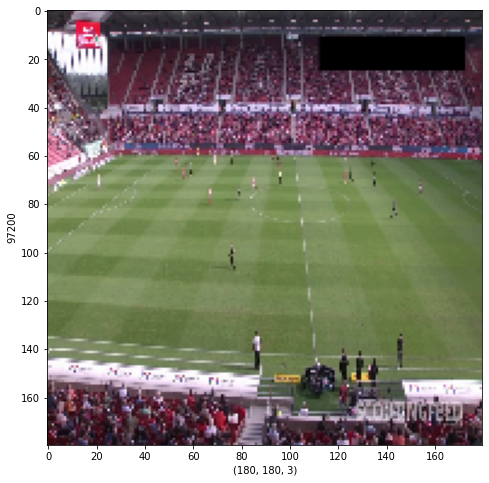

In [21]:
figure = plt.figure(figsize=(8,8))

Pick_IMG = video_one_list[100]
plt.xlabel(Pick_IMG.shape)
plt.ylabel(Pick_IMG.size)
plt.imshow(Pick_IMG);

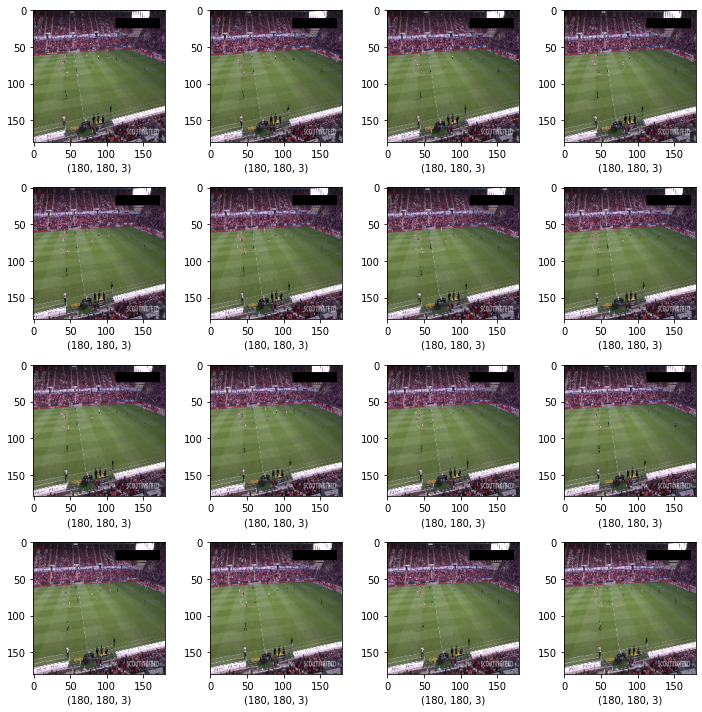

In [22]:
fig,axis = plt.subplots(4,4,figsize=(10,10))

for i,ax in enumerate(axis.flat):
    
    IMG_From_List = video_one_list[i]
    ax.set_xlabel(IMG_From_List.shape)
    ax.imshow(IMG_From_List)
    
plt.tight_layout()
plt.show()

### Get image from frame

In [23]:
# reference : https://www.kaggle.com/coldfir3/eda-helmet-keypoint-tracking-data-comparison
import PIL.Image
def get_frame_from_video(video_path, frame):
    video_path = video_path
    frame = frame - 1
    
    !ffmpeg \
        -hide_banner \
        -loglevel fatal \
        -nostats \
        -i $video_path -vf "select=eq(n\,$frame)" -vframes 1 frame.jpg
    
    img = PIL.Image.open('frame.jpg')#StackOverflow https://stackoverflow.com/questions/10748822/img-image-openfp-attributeerror-class-image-has-no-attribute-open
    os.remove('frame.jpg') 
    return img

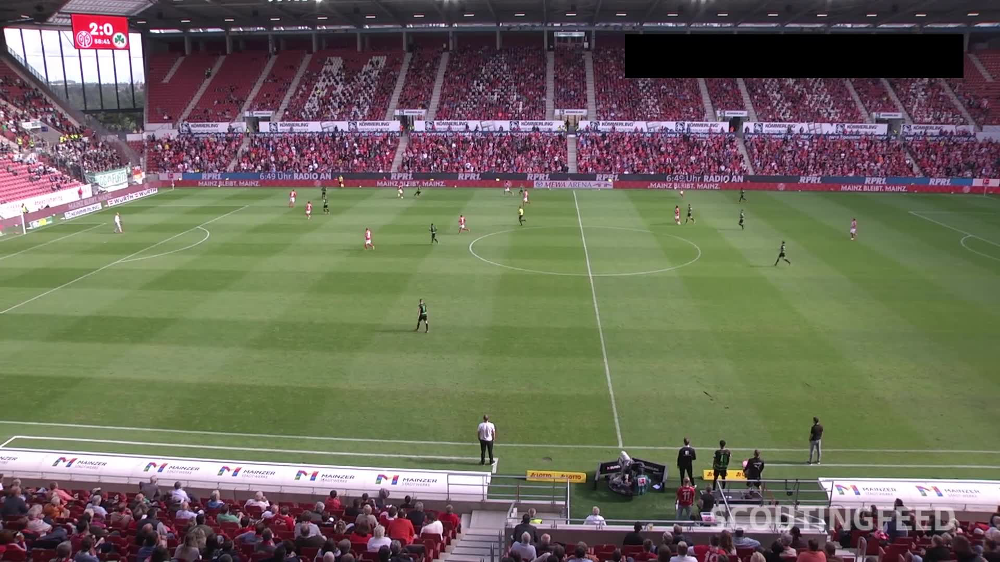

In [24]:
get_frame_from_video('../input/dfl-bundesliga-data-shootout/test/019d5b34_0.mp4', 110)

In [25]:
#Code by Ducky https://www.kaggle.com/code/illgamhoduck/nfl-starter-eda

from IPython.display import Video, display

def video(video_path, ratio=0.7):
    nfl_video = Video(video_path,
                      embed=True,
                      height=int(720 * ratio),
                      width=int(1280 * ratio))
    return nfl_video
    
video('../input/dfl-bundesliga-data-shootout/test/019d5b34_0.mp4')